In [39]:
%load_ext autoreload
%autoreload 2
import sys
import os
while not os.getcwd().endswith("test_project"):
    os.chdir("..")
    print(os.getcwd())
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.image import imread

from tqdm.auto import tqdm
import torch
import torchvision.transforms.v2 as transforms
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
from torchvision.utils import make_grid
import polars as pl

from scripts.image_generator import ImageDatasetGenerator
from scripts.image_factory import *
from scripts.images import (
    plot_histogram, 
    plotly_similarity_metric, 
    plotly_boxplot_metric,
    get_transform_pipeline,
    evaluate_transformations,
    transform_and_save,
)
import warnings
from torchvision import models
import torch.nn as nn
%matplotlib inline
warnings.filterwarnings('ignore')
# from alibi_detect.cd import MMDDrift
# set tight layout
plt.rcParams.update({'figure.autolayout': True})

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [40]:
seed = 42
if torch.cuda.is_available():
    device = torch.device('cuda')
elif torch.backends.mps.is_available():
    device = torch.device('mps')
else:
    device = torch.device('cpu')
torch.set_default_device(device)
print(f"Supported device: {device}.")
g_seed = torch.Generator(device=device)
g_seed.manual_seed(seed);

Supported device: mps.


In [41]:
mean=[0.485, 0.456, 0.406]
std=[0.229, 0.224, 0.225]
batch_size = 32

In [42]:
tensor_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    # transforms.Normalize(mean=mean, std=std)
])

In [43]:
denormalize_transform = transforms.Compose([
    transforms.Normalize(
        mean=[-m / s for m, s in zip(mean, std)],
        std=[1 / s for s in std]
    ),
])

In [44]:
img_path = "../../data/places/"
dataset = ImageFolder(
    root=img_path,
    transform=tensor_transform
)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, generator=g_seed if device.type == 'cuda' or device.type == 'mps' else None)

In [45]:
model = models.resnet18(pretrained=True)
model = nn.Sequential(*list(model.children())[:-1])
model = model.to(device)  # Remove the classification layer
model.eval();

In [46]:
drift_levels = np.round(np.arange(0.1, 1.1, 0.1), 2)
print(drift_levels)

[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9 1. ]


## Brightness & Contrast

Brightness:   0%|          | 0/10 [00:00<?, ?it/s]

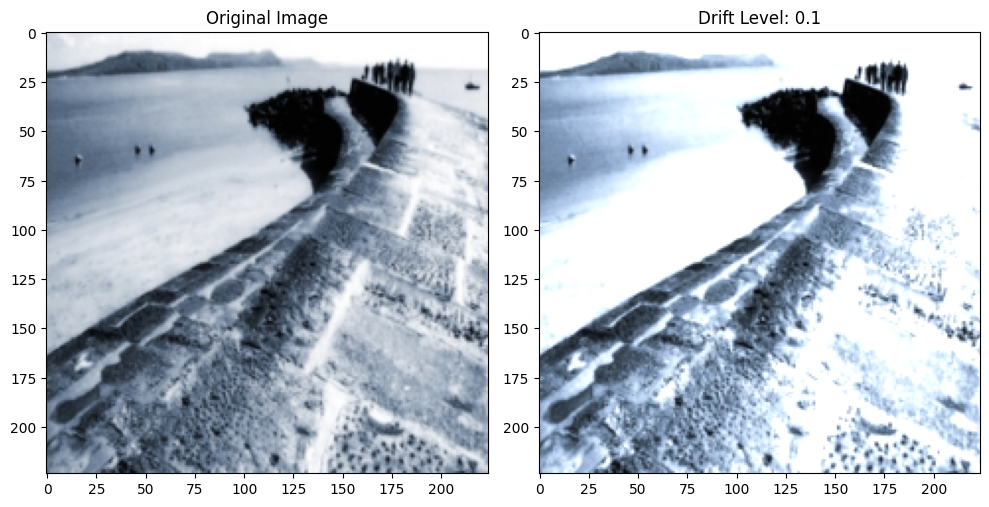

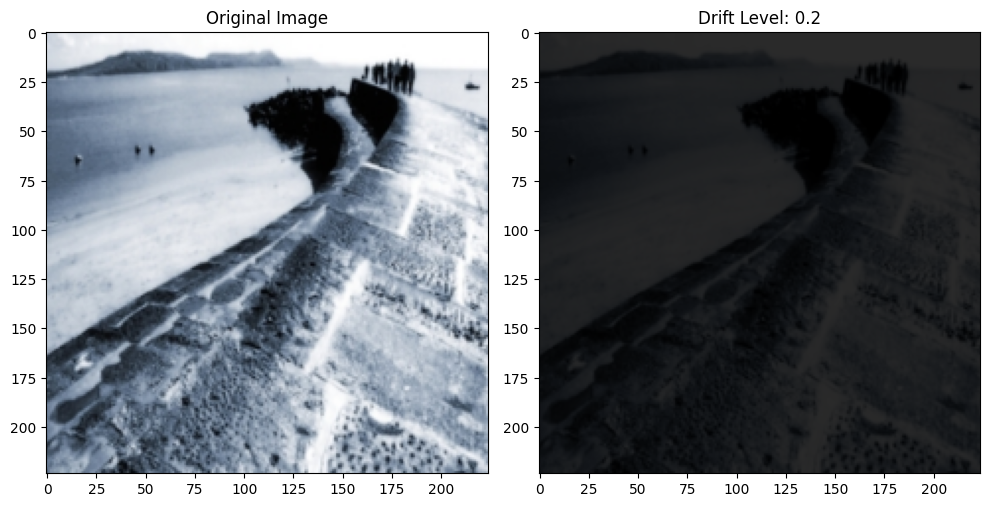

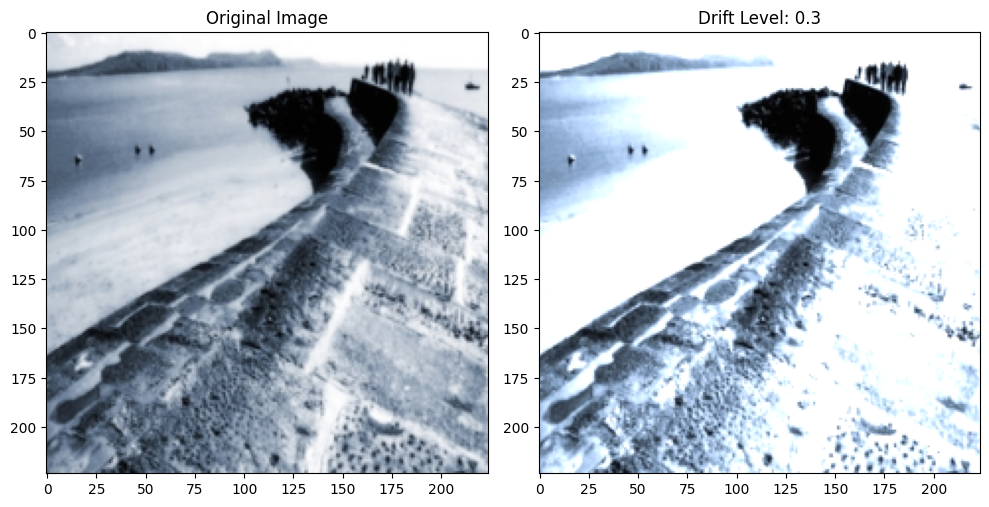

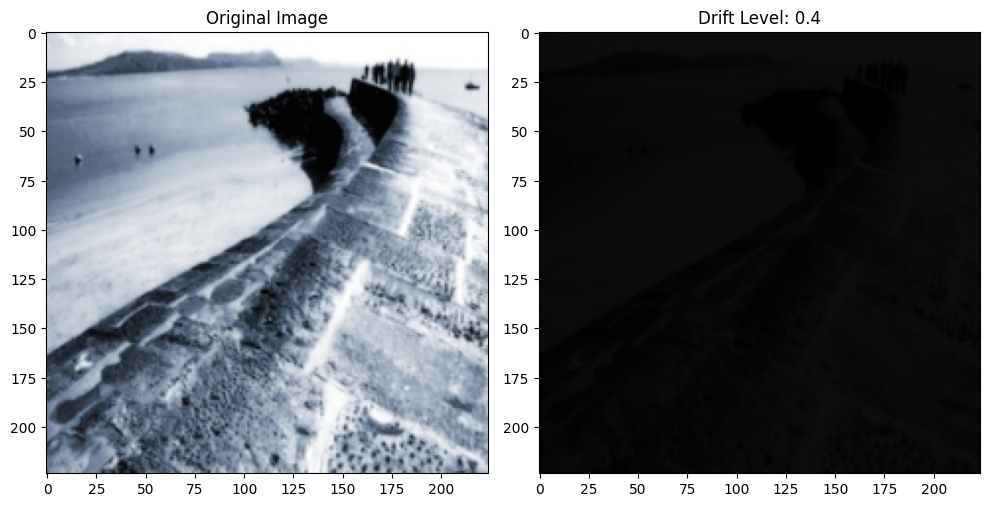

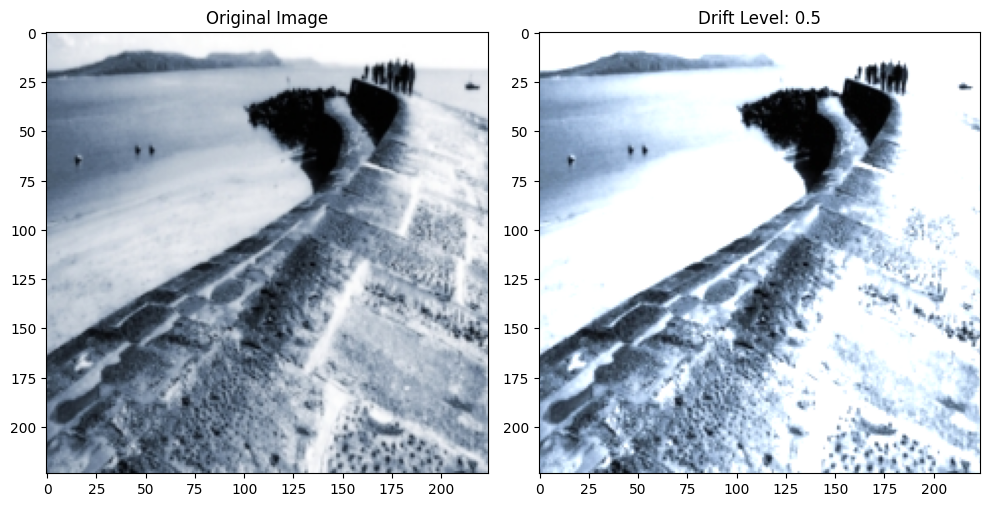

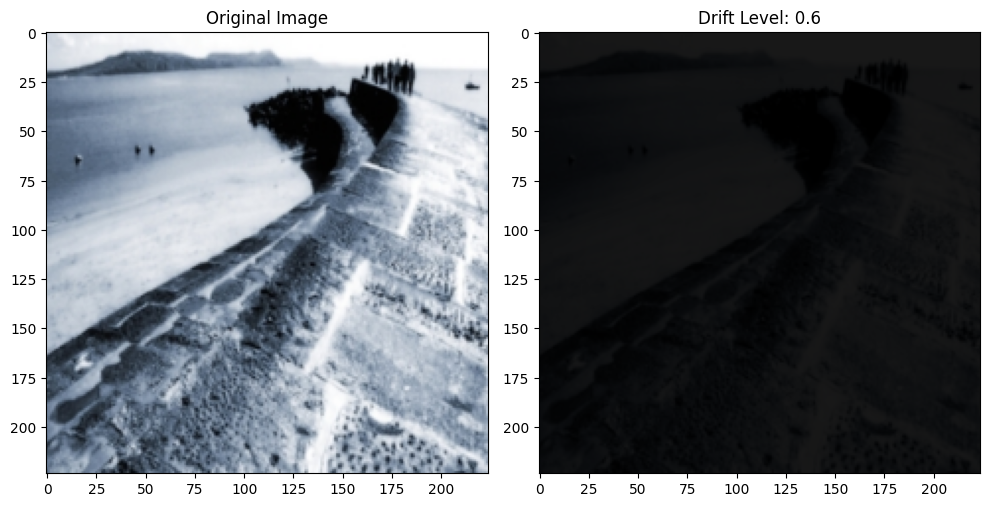

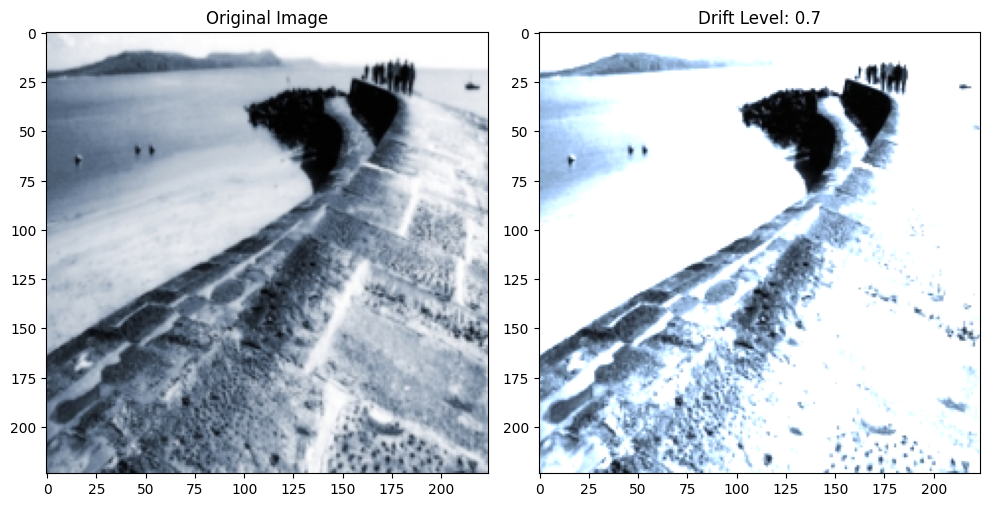

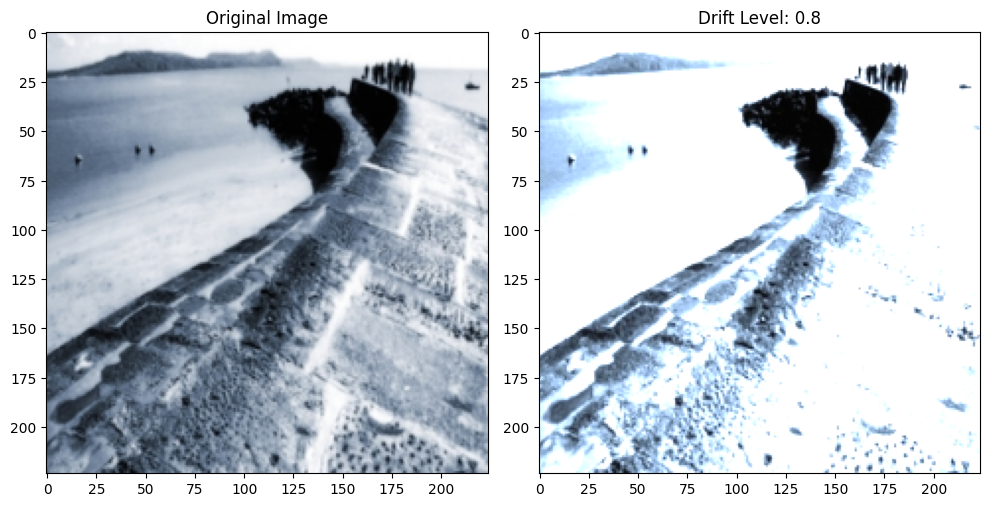

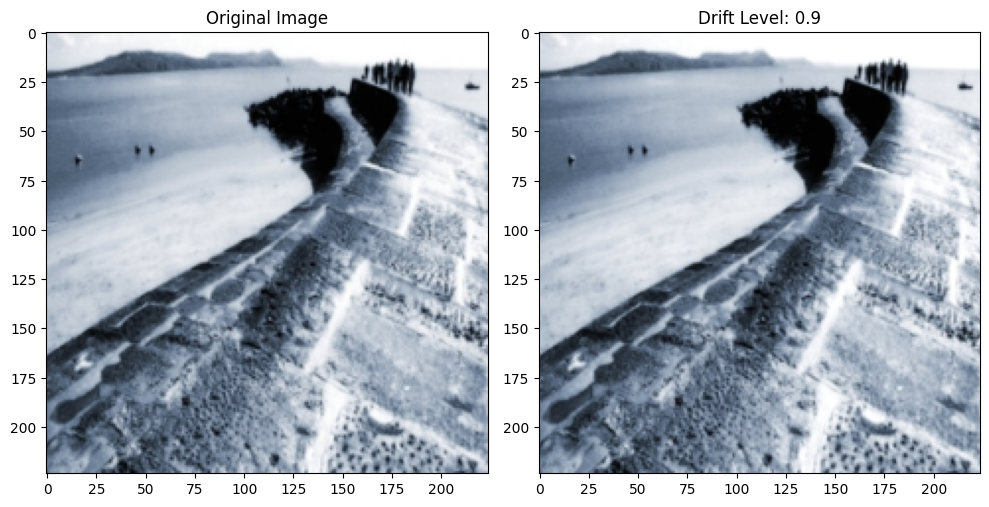

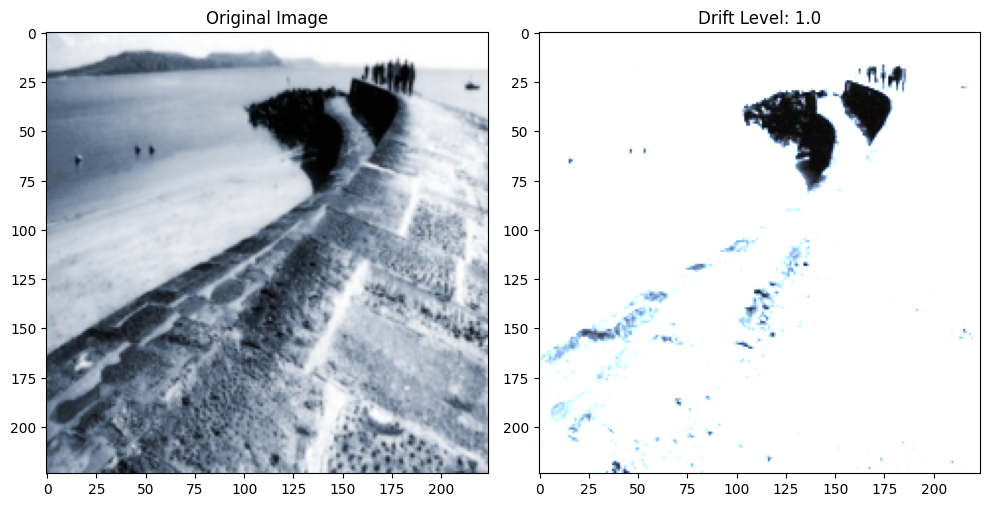

Contrast:   0%|          | 0/10 [00:00<?, ?it/s]

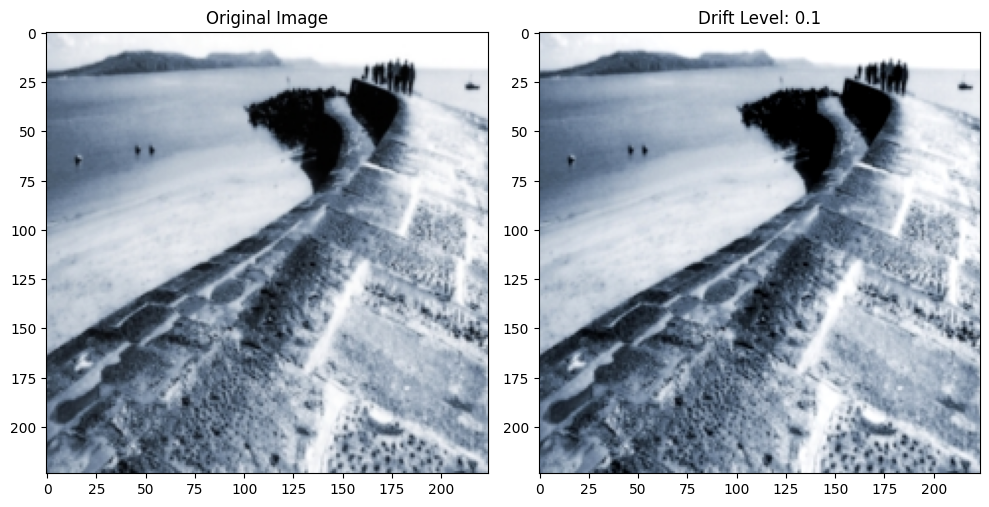

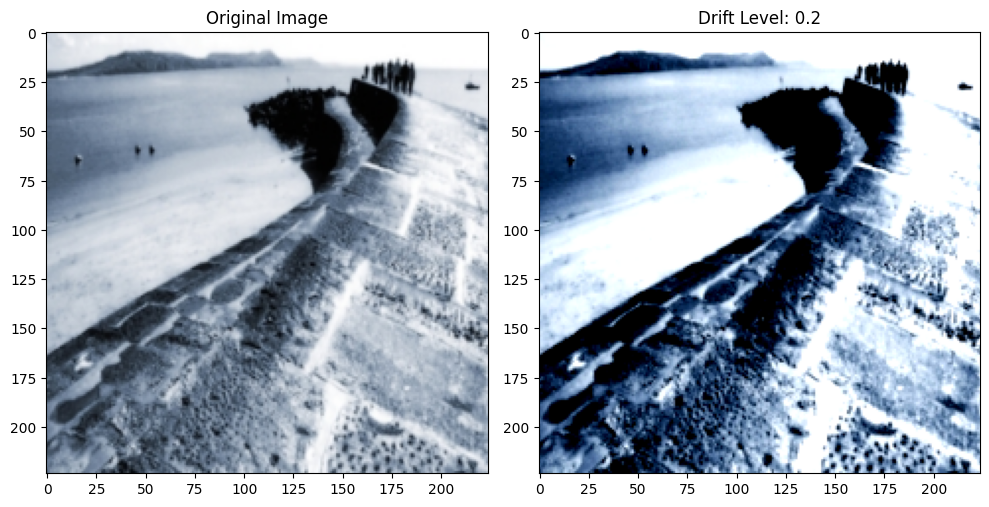

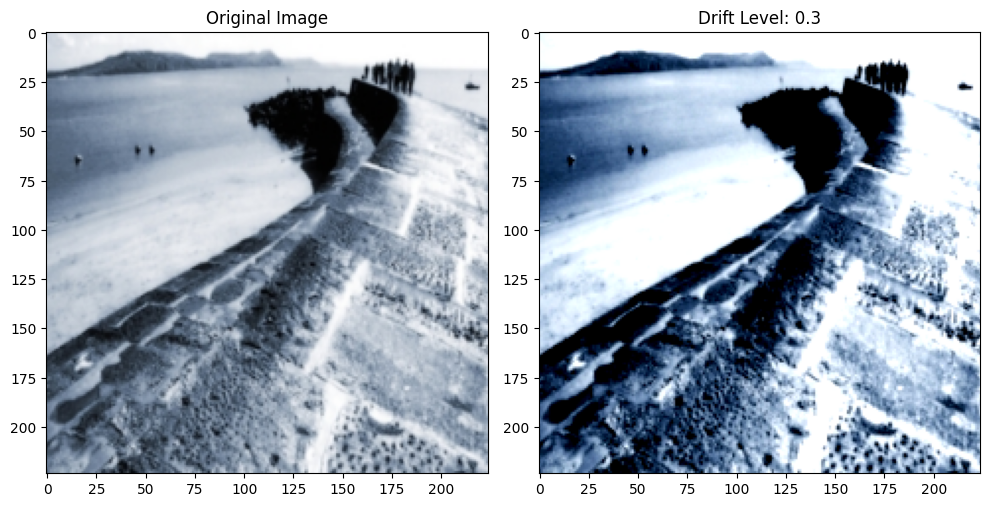

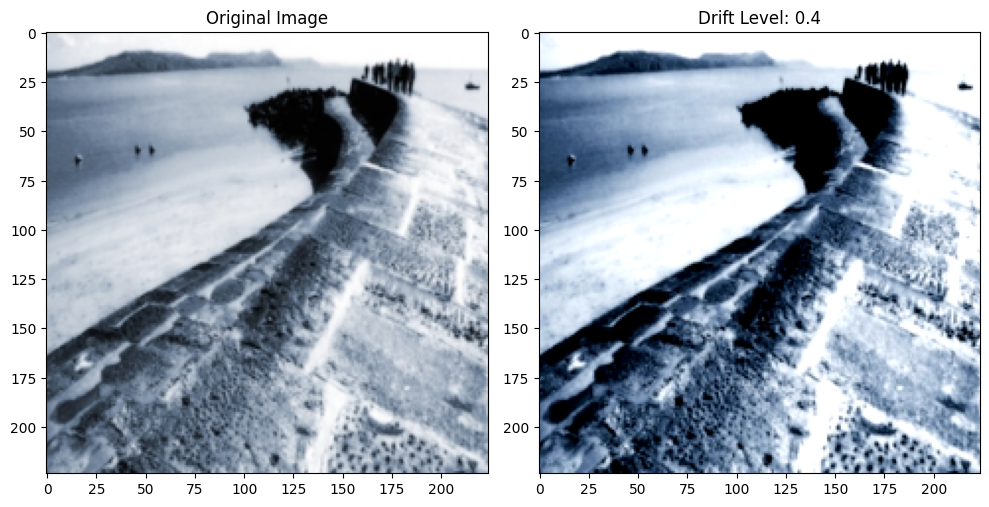

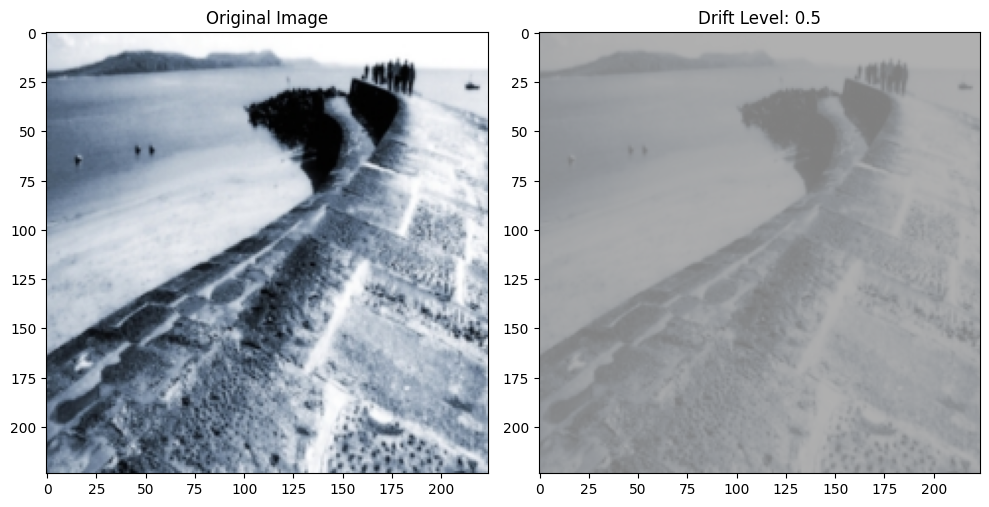

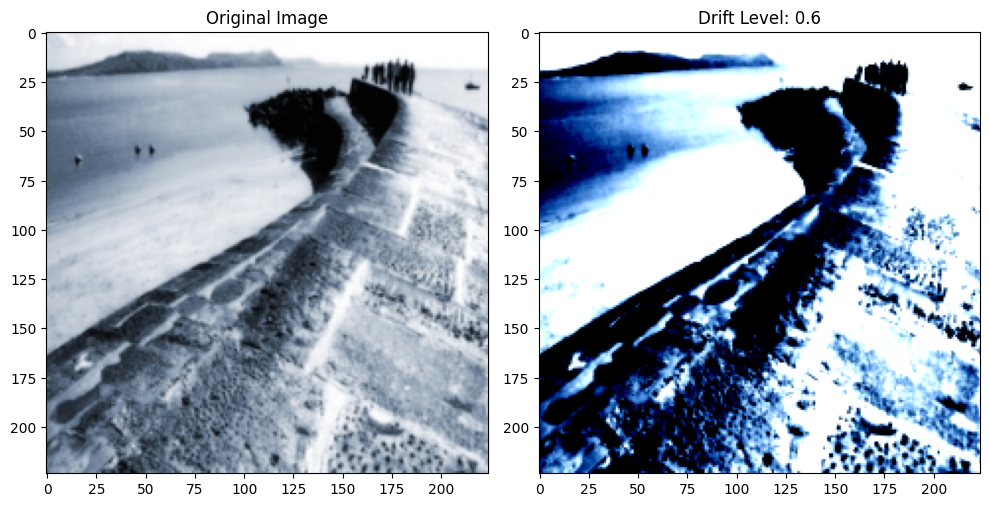

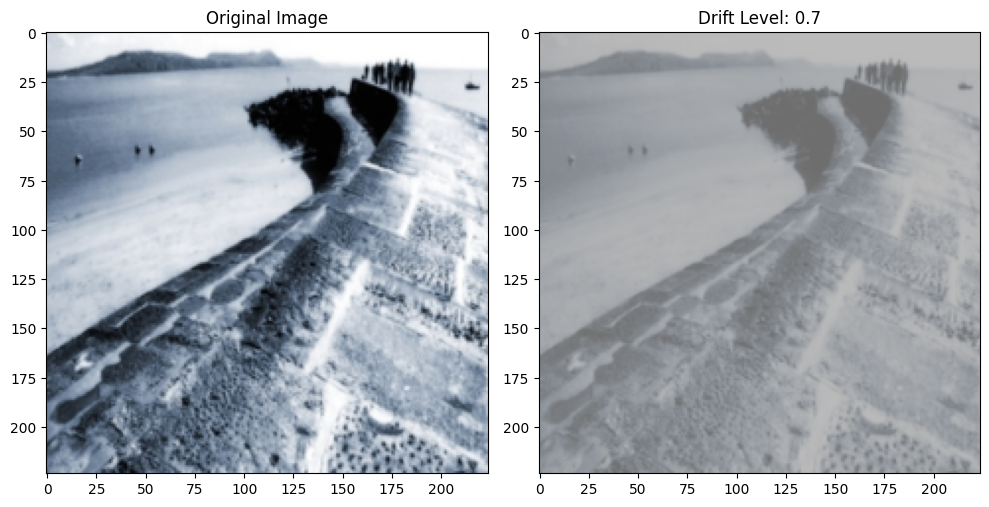

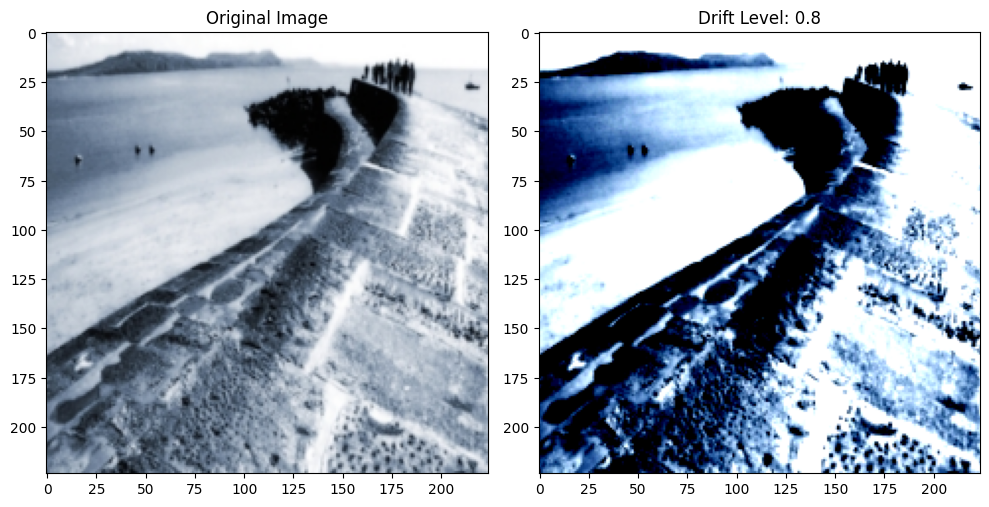

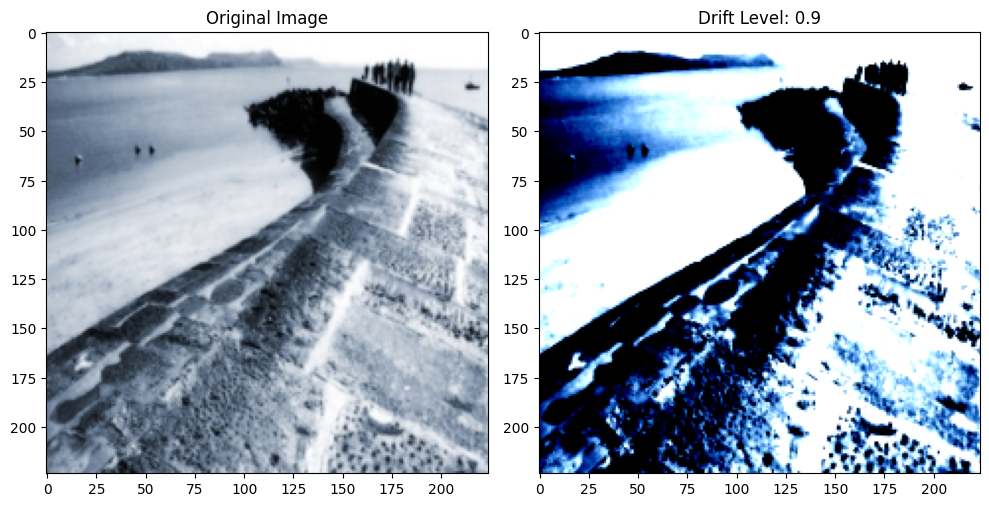

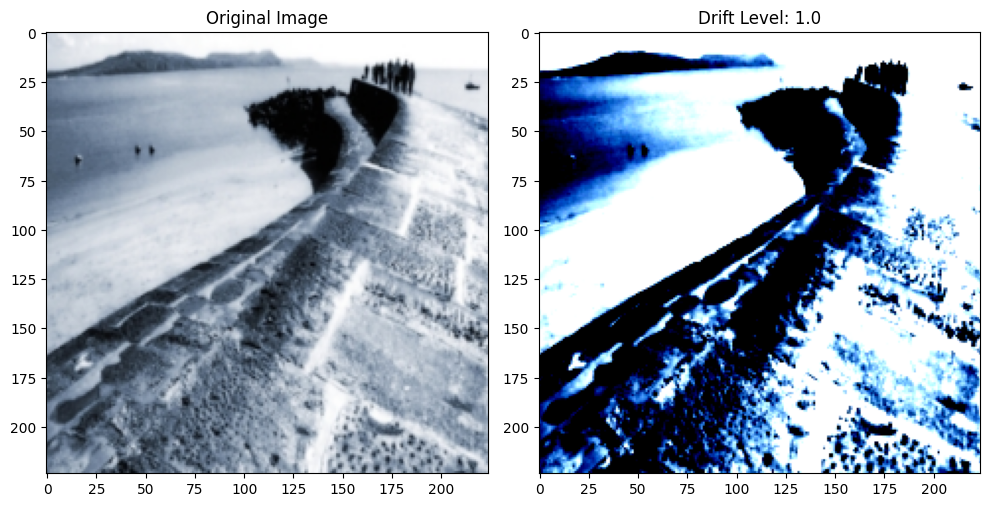

In [47]:
brightness_transformation_lists = [
    [
        TransformInfo(
            transf_type='brightness',
            drift_level=drift_levels[i],
        ),
    ] for i in range(len(drift_levels))
]

contrast_transformation_lists = [
    [
        TransformInfo(
            transf_type='contrast',
            drift_level=drift_levels[i],
        ),
    ] for i in range(len(drift_levels))
]
for transform_list in tqdm(brightness_transformation_lists, desc='Brightness', total=len(brightness_transformation_lists),):
    transform_pipe = get_transform_pipeline(transform_list)
    transform_pipe = transforms.Compose(transform_pipe)
    for i in range(1):
        fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
        axes[0].imshow(dataset[i][0].permute(1, 2, 0))
        axes[1].imshow(transform_pipe(dataset[i][0]).permute(1, 2, 0))
        axes[0].set_title('Original Image')
        axes[1].set_title(f"Drift Level: {transform_list[0].drift_level}")
        plt.show()

for transform_list in tqdm(contrast_transformation_lists, desc='Contrast', total=len(brightness_transformation_lists),):
    transform_pipe = get_transform_pipeline(transform_list)
    transform_pipe = transforms.Compose(transform_pipe)
    for i in range(1):
        fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
        axes[0].imshow(dataset[i][0].permute(1, 2, 0))
        axes[1].imshow(transform_pipe(dataset[i][0]).permute(1, 2, 0))
        axes[0].set_title('Original Image')
        axes[1].set_title(f"Drift Level: {transform_list[0].drift_level}")
        plt.show()

## Rotation Transformation

In [18]:
rotate_transform_lists = [
    [
        TransformInfo(
            transf_type='rotate',
            drift_level=drift_levels[i],
        ),
    ] for i in range(len(drift_levels))
]

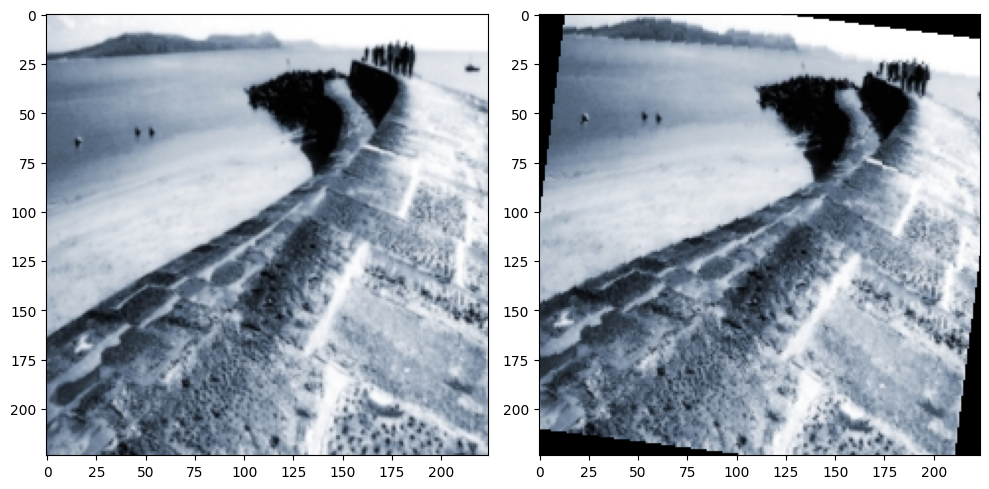

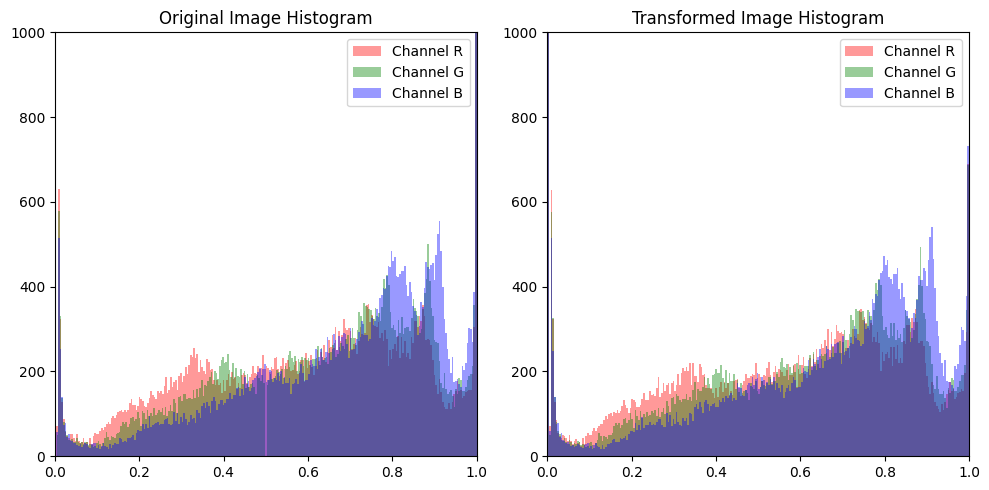

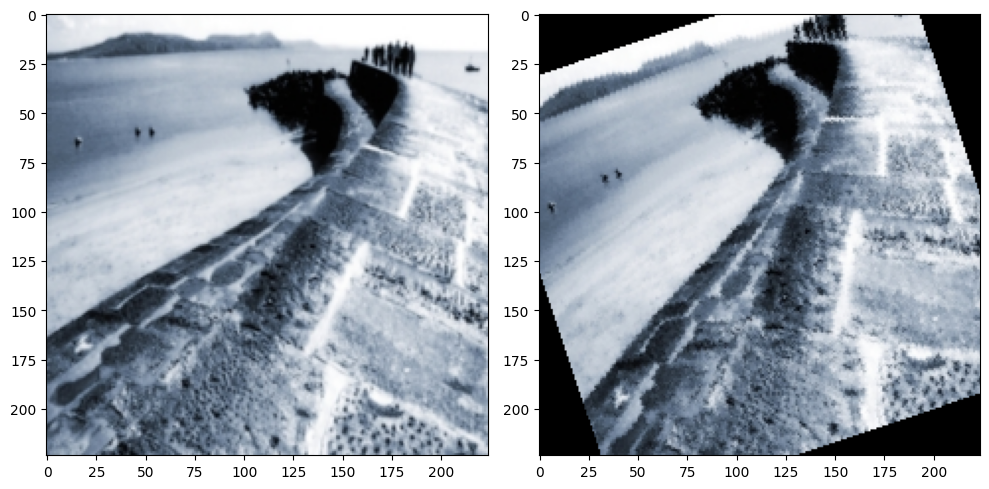

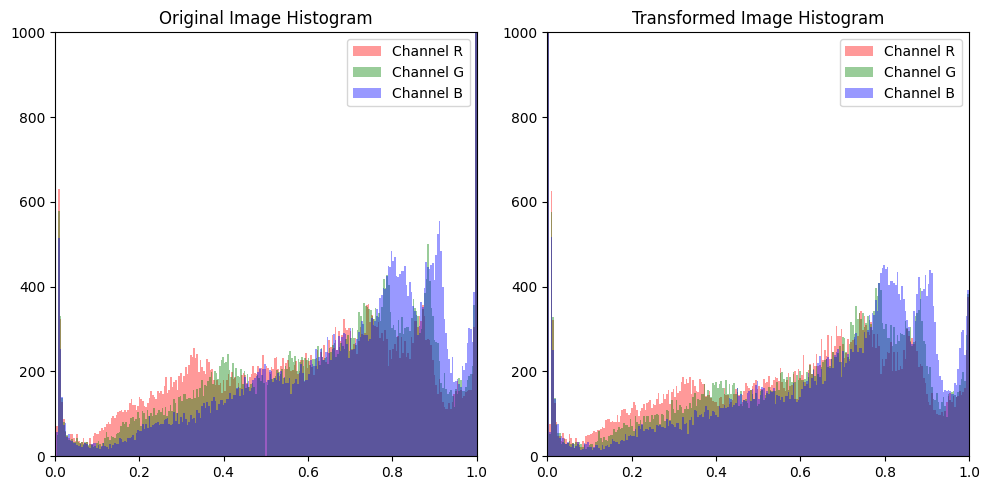

In [19]:
# Minimum Drift Level: 0.1
rotate_transform_pipe = get_transform_pipeline(rotate_transform_lists[0])
rotate_transform_pipe = transforms.Compose(rotate_transform_pipe)
for i in range(1):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
    axes[0].imshow(dataset[i][0].permute(1, 2, 0))
    axes[1].imshow(rotate_transform_pipe(dataset[i][0]).permute(1, 2, 0))
    plt.show()
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
    plot_histogram(dataset[i][0].permute(1, 2, 0), axes[0], 'Original Image Histogram')
    plot_histogram(rotate_transform_pipe(dataset[i][0]).permute(1, 2, 0), axes[1], 'Transformed Image Histogram')
    plt.show();

# Maximum Drift Level: 1.0
rotate_transform_pipe = get_transform_pipeline(rotate_transform_lists[-2])
rotate_transform_pipe = transforms.Compose(rotate_transform_pipe)
for i in range(1):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
    axes[0].imshow(dataset[i][0].permute(1, 2, 0))
    axes[1].imshow(rotate_transform_pipe(dataset[i][0]).permute(1, 2, 0))
    plt.show()
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
    plot_histogram(dataset[i][0].permute(1, 2, 0), axes[0], 'Original Image Histogram')
    plot_histogram(rotate_transform_pipe(dataset[i][0]).permute(1, 2, 0), axes[1], 'Transformed Image Histogram')
    plt.show();

In [20]:
from param import output


transform_list = [
    TransformInfo(
        transf_type='rotate',
        drift_level=drift_levels[-1],
    ),
]
transform_and_save(
    dataloader=dataloader,
    transform_list=transform_list,
    output_path='../../data/test_rotate',
)

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

In [21]:
rotate_results = []
for transform_list in tqdm(rotate_transform_lists, desc='Transformations', total=len(rotate_transform_lists),):
    rotate_results.append(
        evaluate_transformations(
            model=model,
            dataloader=dataloader,
            transform_list=transform_list
        )
    )
# Flatten the rotate_results
rotate_results = [item for sublist in rotate_results for item in sublist]
rotate_df = pl.DataFrame(rotate_results)
rotate_df.head()
rotate_grouped_df = rotate_df.group_by(["Drift Level"]).agg(
    [
        pl.col("KL Divergence").alias("KL Divergence"),
        pl.col("Cosine Similarity").alias("Cosine Similarity"),
        pl.col("Cosine Similarity").alias("KL Divergence Color"),
    ]
).sort("Drift Level")

Transformations:   0%|          | 0/10 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

In [22]:
plotly_similarity_metric(rotate_grouped_df, "KL Divergence", ['Drift Level'], title="Rotate")
plotly_similarity_metric(rotate_grouped_df, "Cosine Similarity", ['Drift Level'], title="Rotate")

In [23]:
plotly_boxplot_metric(rotate_grouped_df, "KL Divergence", ['Drift Level'], title="Rotate")
plotly_boxplot_metric(rotate_grouped_df, "Cosine Similarity", ['Drift Level'], title="Rotate")

## Color Jitter Transformation
- Brightness
- Contrast
- Saturation
- Hue

In [24]:
color_jitter_transform_lists = [
    [
        TransformInfo(
            transf_type='brightness',
            drift_level=drift_levels[i],
        ),
        TransformInfo(
            transf_type='contrast',
            drift_level=drift_levels[i],
        ),
        TransformInfo(
            transf_type='hue',
            drift_level=drift_levels[i],
        ),
        TransformInfo(
            transf_type='saturation',
            drift_level=drift_levels[i],
        ),
    ] for i in range(len(drift_levels))
]

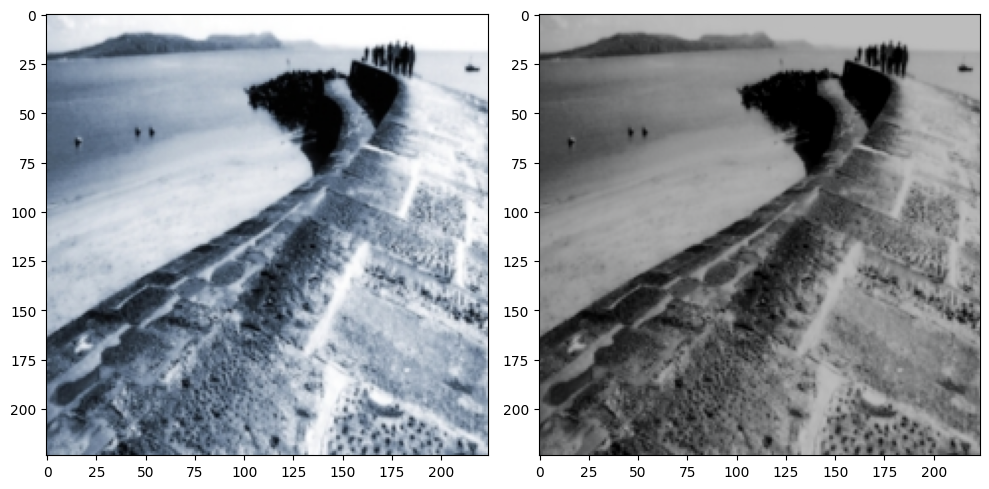

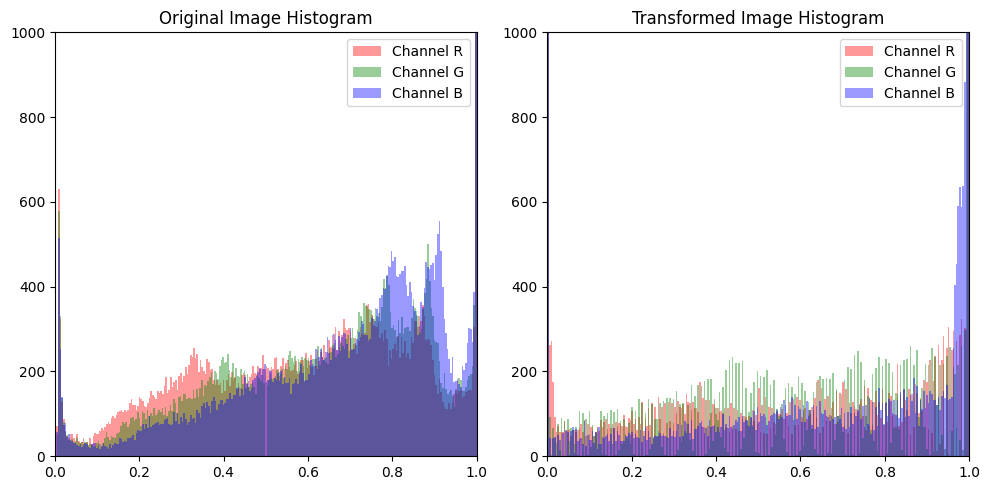

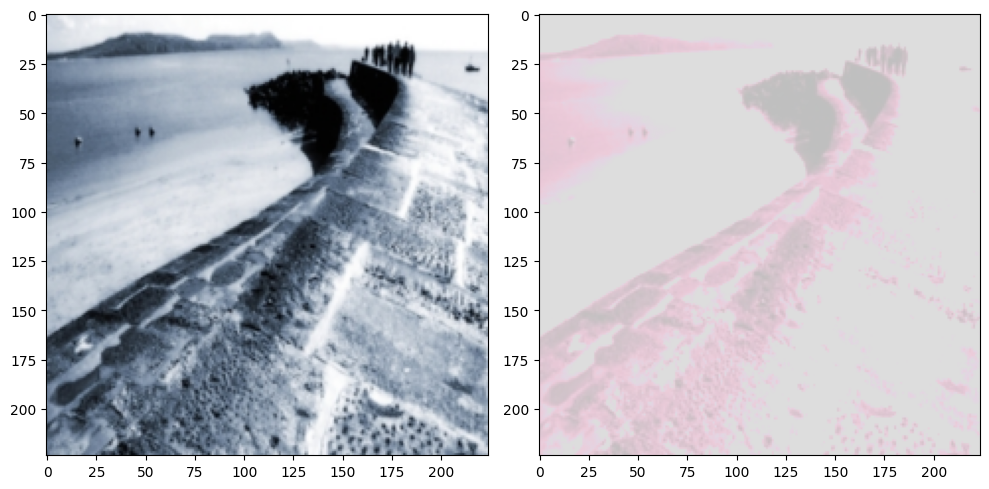

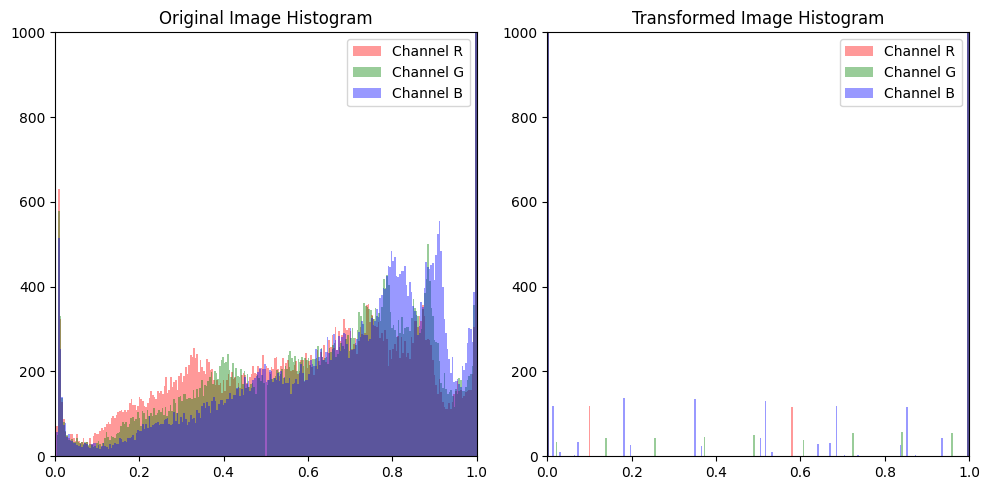

In [25]:
# Minimum Drift Level: 0.1
color_jitter_transform_pipe = get_transform_pipeline(color_jitter_transform_lists[0])
color_jitter_transform_pipe = transforms.Compose(color_jitter_transform_pipe)
for i in range(1):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
    axes[0].imshow(dataset[i][0].permute(1, 2, 0))
    axes[1].imshow(color_jitter_transform_pipe(dataset[i][0]).permute(1, 2, 0))
    plt.show()
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
    plot_histogram(dataset[i][0].permute(1, 2, 0), axes[0], 'Original Image Histogram')
    plot_histogram(color_jitter_transform_pipe(dataset[i][0]).permute(1, 2, 0), axes[1], 'Transformed Image Histogram')
    plt.show();

# Maximum Drift Level: 1.0
color_jitter_transform_pipe = get_transform_pipeline(color_jitter_transform_lists[-1])
color_jitter_transform_pipe = transforms.Compose(color_jitter_transform_pipe)
for i in range(1):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
    axes[0].imshow(dataset[i][0].permute(1, 2, 0))
    axes[1].imshow(color_jitter_transform_pipe(dataset[i][0]).permute(1, 2, 0))
    plt.show()
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
    plot_histogram(dataset[i][0].permute(1, 2, 0), axes[0], 'Original Image Histogram')
    plot_histogram(color_jitter_transform_pipe(dataset[i][0]).permute(1, 2, 0), axes[1], 'Transformed Image Histogram')
    plt.show();

In [26]:
color_jitter_results = []
for transform_list in tqdm(color_jitter_transform_lists, desc='Transformations', total=len(color_jitter_transform_lists),):
    color_jitter_results.append(
        evaluate_transformations(
            model=model,
            dataloader=dataloader,
            transform_list=transform_list
        )
    )
# Flatten the color_jitter_results
color_jitter_results = [item for sublist in color_jitter_results for item in sublist]

color_jitter_df = pl.DataFrame(color_jitter_results)
color_jitter_df.head()
color_jitter_grouped_df = color_jitter_df.group_by(["Drift Level"]).agg(
    [
        pl.col("KL Divergence").alias("KL Divergence"),
        pl.col("Cosine Similarity").alias("Cosine Similarity"),
        pl.col("Cosine Similarity").alias("KL Divergence Color"),
    ]
).sort("Drift Level")

Transformations:   0%|          | 0/10 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

In [27]:
plotly_similarity_metric(color_jitter_grouped_df, "KL Divergence", ['Drift Level'], title="Color Jitter")
plotly_similarity_metric(color_jitter_grouped_df, "Cosine Similarity", ['Drift Level'], title="Color Jitter")

In [28]:
plotly_boxplot_metric(color_jitter_grouped_df, "KL Divergence", ['Drift Level'], title="Color Jitter")
plotly_boxplot_metric(color_jitter_grouped_df, "Cosine Similarity", ['Drift Level'], title="Color Jitter")

## Gaussian Blur Transformation

In [29]:
gaussian_blur_transform_lists = [
    [
        TransformInfo(
            transf_type='gaussian_blur',
            drift_level=drift_levels[i],
        ),
    ] for i in range(len(drift_levels))
]

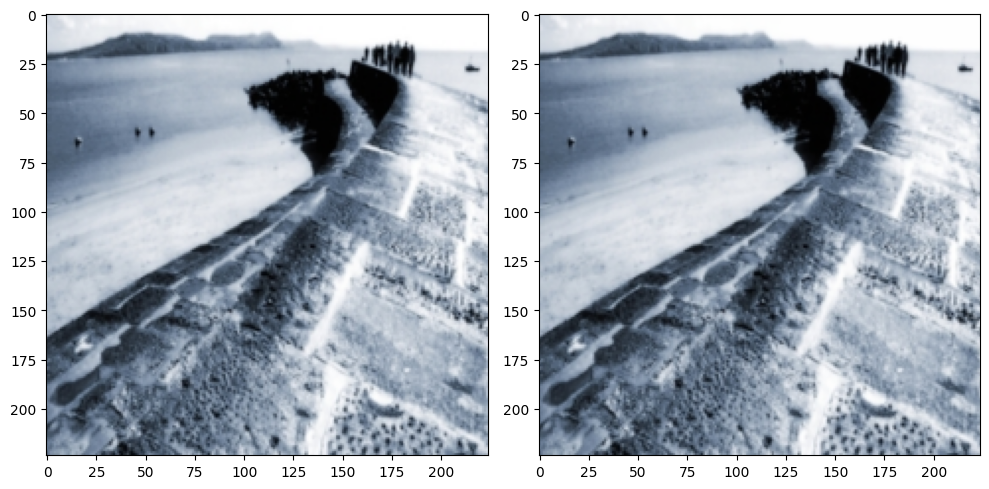

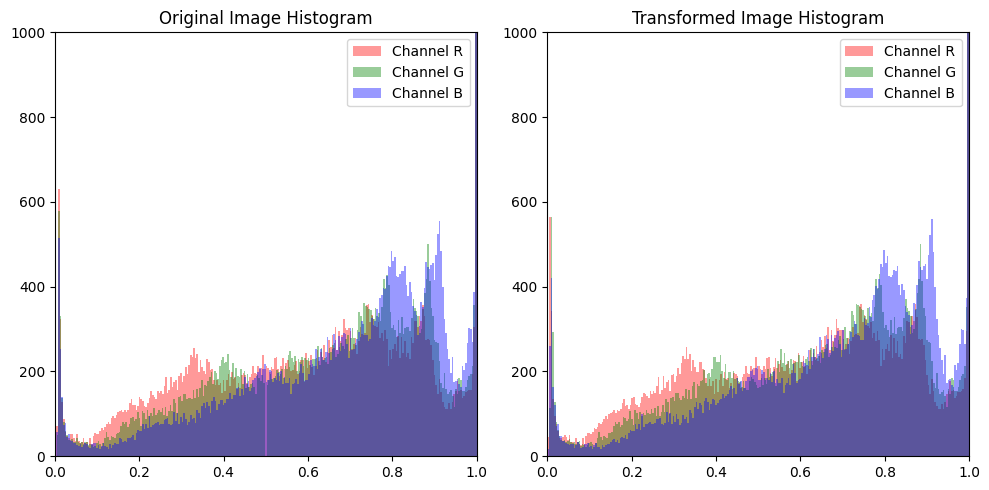

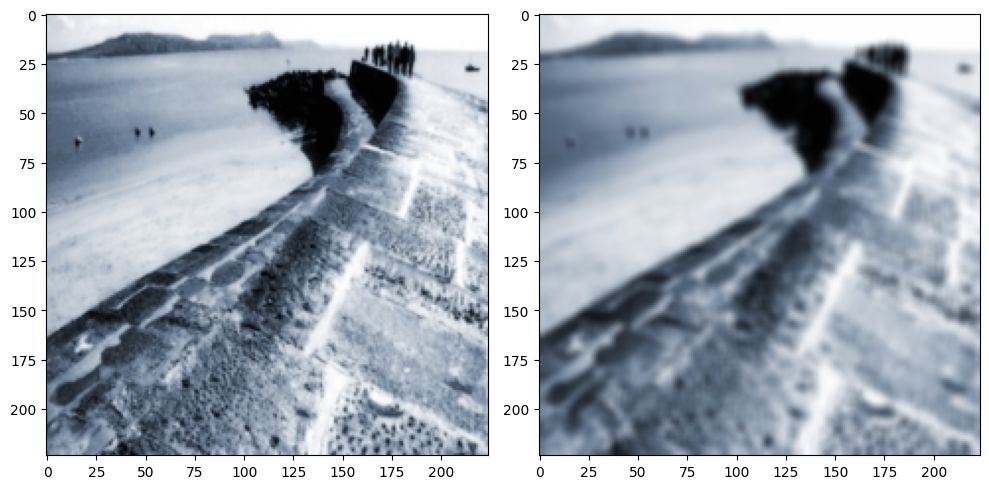

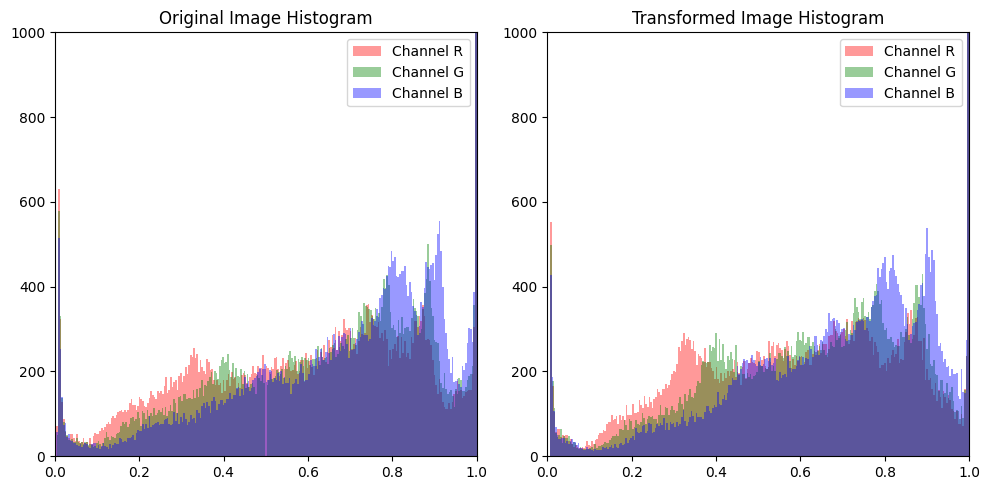

In [30]:
# Minimum Drift Level: 0.1
gaussian_blur_transform_pipe = get_transform_pipeline(gaussian_blur_transform_lists[0])
gaussian_blur_transform_pipe = transforms.Compose(gaussian_blur_transform_pipe)
for i in range(1):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
    axes[0].imshow(dataset[i][0].permute(1, 2, 0))
    axes[1].imshow(gaussian_blur_transform_pipe(dataset[i][0]).permute(1, 2, 0))
    plt.show()
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
    plot_histogram(dataset[i][0].permute(1, 2, 0), axes[0], 'Original Image Histogram')
    plot_histogram(gaussian_blur_transform_pipe(dataset[i][0]).permute(1, 2, 0), axes[1], 'Transformed Image Histogram')
    plt.show();

# Maximum Drift Level: 1.0
gaussian_blur_transform_pipe = get_transform_pipeline(gaussian_blur_transform_lists[-1])
gaussian_blur_transform_pipe = transforms.Compose(gaussian_blur_transform_pipe)
for i in range(1):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
    axes[0].imshow(dataset[i][0].permute(1, 2, 0))
    axes[1].imshow(gaussian_blur_transform_pipe(dataset[i][0]).permute(1, 2, 0))
    plt.show()
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
    plot_histogram(dataset[i][0].permute(1, 2, 0), axes[0], 'Original Image Histogram')
    plot_histogram(gaussian_blur_transform_pipe(dataset[i][0]).permute(1, 2, 0), axes[1], 'Transformed Image Histogram')
    plt.show();

In [31]:
gaussian_blur_results = []
for transform_list in tqdm(gaussian_blur_transform_lists, desc='Transformations', total=len(gaussian_blur_transform_lists),):
    gaussian_blur_results.append(
        evaluate_transformations(
            model=model,
            dataloader=dataloader,
            transform_list=transform_list
        )
    )
# Flatten the gaussian_blur_results
gaussian_blur_results = [item for sublist in gaussian_blur_results for item in sublist]

gaussian_blur_df = pl.DataFrame(gaussian_blur_results)
gaussian_blur_df.head()
gaussian_blur_grouped_df = gaussian_blur_df.group_by(["Drift Level"]).agg(
    [
        pl.col("KL Divergence").alias("KL Divergence"),
        pl.col("Cosine Similarity").alias("Cosine Similarity"),
        pl.col("Cosine Similarity").alias("KL Divergence Color"),
    ]
).sort("Drift Level")

Transformations:   0%|          | 0/10 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

In [32]:
plotly_similarity_metric(gaussian_blur_grouped_df, "KL Divergence", ['Drift Level'], title="Gaussian Blur")
plotly_similarity_metric(gaussian_blur_grouped_df, "Cosine Similarity", ['Drift Level'], title="Gaussian Blur")

In [33]:
plotly_boxplot_metric(gaussian_blur_grouped_df, "KL Divergence", ['Drift Level'], title="Gaussian Blur")
plotly_boxplot_metric(gaussian_blur_grouped_df, "Cosine Similarity", ['Drift Level'], title="Gaussian Blur")

## Gaussian Noise Transformation

In [34]:
gaussian_noise_transform_lists = [
    [
        TransformInfo(
            transf_type='gaussian_noise',
            drift_level=drift_levels[i],
        ),
    ] for i in range(len(drift_levels))
]

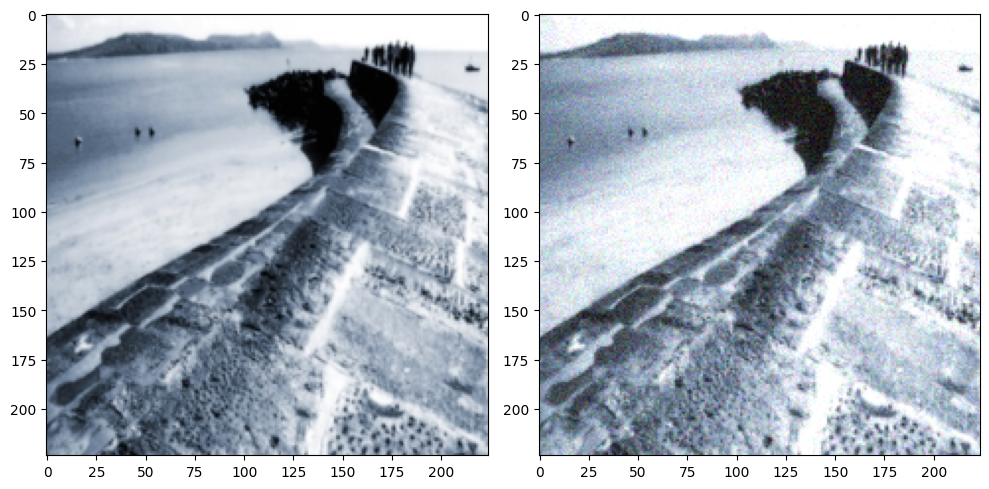

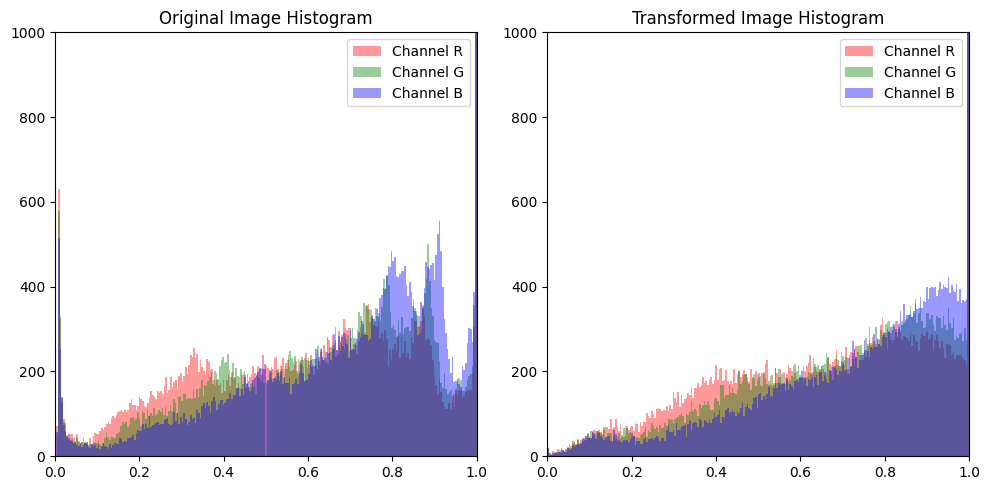

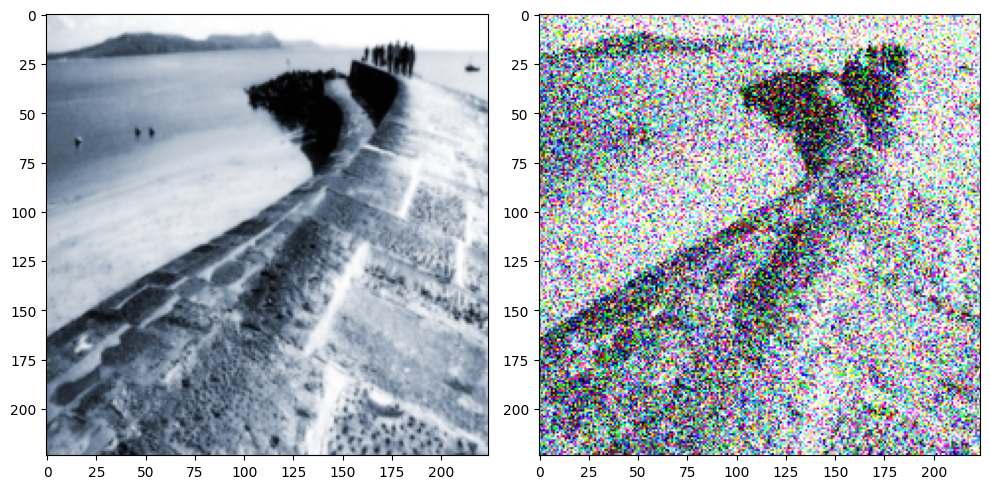

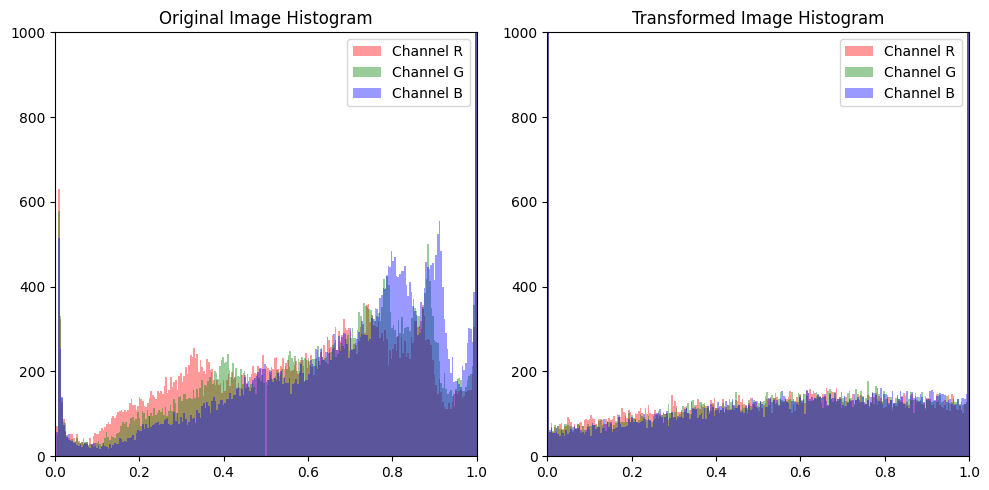

In [35]:
# Minimum Drift Level: 0.1
gaussian_noise_transform_pipe = get_transform_pipeline(gaussian_noise_transform_lists[0])
gaussian_noise_transform_pipe = transforms.Compose(gaussian_noise_transform_pipe)
for i in range(1):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
    axes[0].imshow(dataset[i][0].permute(1, 2, 0))
    axes[1].imshow(gaussian_noise_transform_pipe(dataset[i][0]).permute(1, 2, 0))
    plt.show()
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
    plot_histogram(dataset[i][0].permute(1, 2, 0), axes[0], 'Original Image Histogram')
    plot_histogram(gaussian_noise_transform_pipe(dataset[i][0]).permute(1, 2, 0), axes[1], 'Transformed Image Histogram')
    plt.show();

# Maximum Drift Level: 1.0
gaussian_noise_transform_pipe = get_transform_pipeline(gaussian_noise_transform_lists[-1])
gaussian_noise_transform_pipe = transforms.Compose(gaussian_noise_transform_pipe)
for i in range(1):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
    axes[0].imshow(dataset[i][0].permute(1, 2, 0))
    axes[1].imshow(gaussian_noise_transform_pipe(dataset[i][0]).permute(1, 2, 0))
    plt.show()
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
    plot_histogram(dataset[i][0].permute(1, 2, 0), axes[0], 'Original Image Histogram')
    plot_histogram(gaussian_noise_transform_pipe(dataset[i][0]).permute(1, 2, 0), axes[1], 'Transformed Image Histogram')
    plt.show();

In [36]:
gaussian_noise_results = []
for transform_list in tqdm(gaussian_noise_transform_lists, desc='Transformations', total=len(gaussian_noise_transform_lists),):
    gaussian_noise_results.append(
        evaluate_transformations(
            model=model,
            dataloader=dataloader,
            transform_list=transform_list
        )
    )
# Flatten the gaussian_noise_results
gaussian_noise_results = [item for sublist in gaussian_noise_results for item in sublist]

gaussian_noise_df = pl.DataFrame(gaussian_noise_results)
gaussian_noise_df.head()
gaussian_noise_grouped_df = gaussian_noise_df.group_by(["Drift Level"]).agg(
    [
        pl.col("KL Divergence").alias("KL Divergence"),
        pl.col("Cosine Similarity").alias("Cosine Similarity"),
        pl.col("Cosine Similarity").alias("KL Divergence Color"),
    ]
).sort("Drift Level")

Transformations:   0%|          | 0/10 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

Processing batches:   0%|          | 0/95 [00:00<?, ?it/s]

In [37]:
plotly_similarity_metric(gaussian_noise_grouped_df, "KL Divergence", ['Drift Level'], title="Gaussian Noise")
plotly_similarity_metric(gaussian_noise_grouped_df, "Cosine Similarity", ['Drift Level'], title="Gaussian Noise")

In [38]:
plotly_boxplot_metric(gaussian_noise_grouped_df, "KL Divergence", ['Drift Level'], title="Gaussian Noise")
plotly_boxplot_metric(gaussian_noise_grouped_df, "Cosine Similarity", ['Drift Level'], title="Gaussian Noise")